## Trying to Account for the Mito

This notebook is focusing just on the T/NK cell clusters that, through looking at marker genes/proteins, seem to have pairs of corresponding clusters, ones that have low mitochondrial content, and others that have high. I want to just focus on these to try a variety of ways of accounting for this mito effect.


In [2]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings
import itertools as it
import json
import requests
import seaborn as sns
import pickle as pkl
from functools import reduce

/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [3]:
sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)
print(sc.__version__)

1.4.5.post1


In [4]:
prefix = '/data/codec/production.run/'

### Load in Data

In [4]:
path = prefix + 'pkls/cts/combat/tnk.pkl'
    
with open(path,'rb') as file:
    tnk = pkl.load(file)

In [5]:
path = prefix + 'mrna/obs/combat/acg.tnk.and.high.mito.bcs.txt'

with open(path,'r') as file:
    extract_bcs = [i.strip() for i in file.readlines()]

In [6]:
np.random.choice(extract_bcs,10)

array(['CATCCACCAATTCGTG-3-3', 'AAGATAGAGAGTTGTA-5-5',
       'TGTCCCAAGCACTCCG-6-6', 'ACTGTCCCATTCTGTT-5-5',
       'GATGTTGCAGTTAAAG-6-6', 'AGCTCAATCAGCTTCC-7-7',
       'AAGCGAGAGGTCTGGA-10-10', 'CATGCAAGTGGTATGG-8-8',
       'ATTCTACAGCCTGTCG-10-10', 'ACATTTCAGCGGTAAC-11-11'], dtype='<U22')

In [7]:
np.random.choice(tnk['adata'].obs_names.values,10)

array(['AGGATCTTCCTTCACG-10-10', 'CCTACGTCATACCGTA-11-11',
       'CACTGAAAGGAGAATG-9-9', 'GTGCTTCCAGCGGATA-7-7',
       'ATGAGTCAGCATGTTC-1-1', 'CCACAAAGTATACGGG-1-1',
       'ATTCGTTTCAGGGTAG-11-11', 'CCTAAGACACCGTACG-2-2',
       'AATGGAACAAGTGACG-8-8', 'GTAGATCAGATAGCAT-4-4'], dtype=object)

In [8]:
for adata in tnk.keys():
    tnk[adata] = tnk[adata][extract_bcs,:].copy()

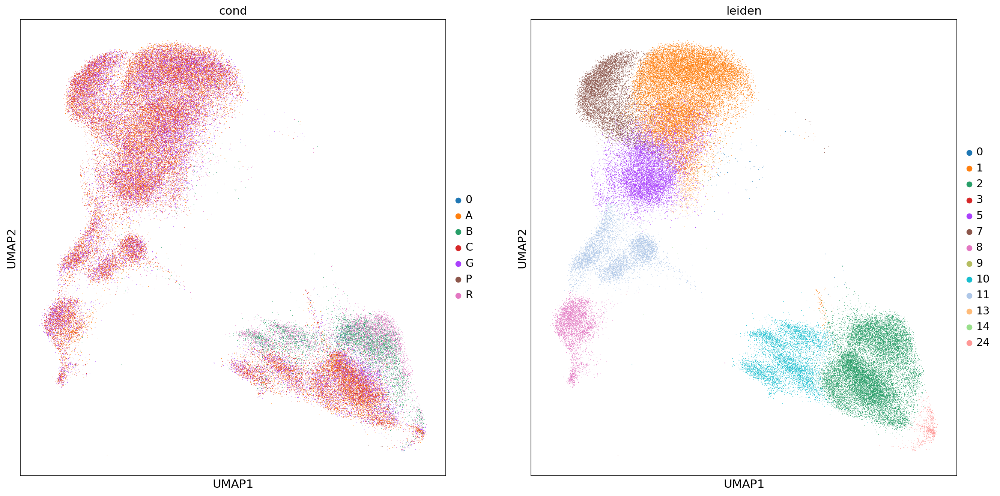

In [9]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['cond', 'leiden'], ax):
    sc.pl.umap(tnk['adata'],color=color, ax=ax, show=False, return_fig=False, size=2)

Separate out my clusters.

In [12]:
ctdict = dict() 
ctdict['hi'] = [2, 10, 24]
ctdict['lo'] = [0, 1, 3, 5, 7, 8, 9, 11, 13, 14]
tnk['adata'].obs['mito'] = tnk['adata'].obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        tnk['adata'].obs['mito'].replace(str(clust), ct, regex=True, inplace=True)
tnk['adata'].obs['mito'] = tnk['adata'].obs['mito'].astype('category')

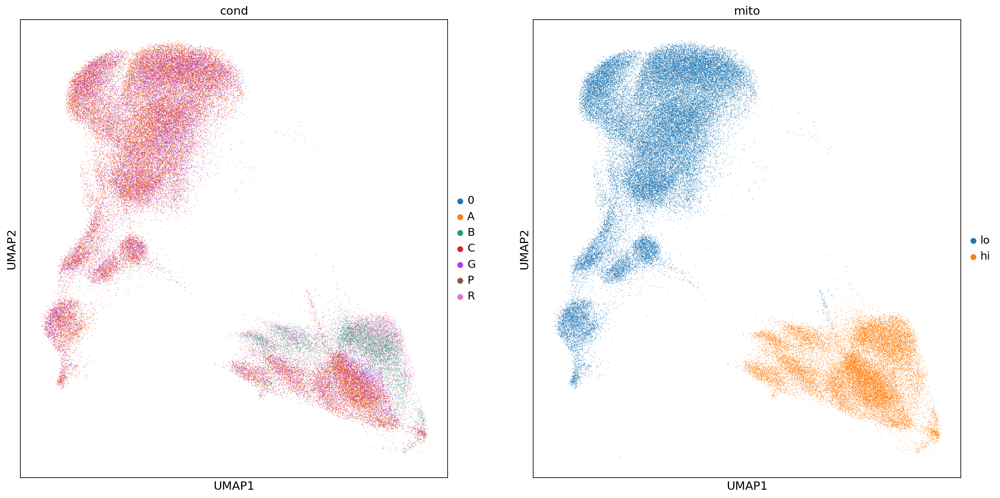

In [13]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['cond', 'mito'], ax):
    sc.pl.umap(tnk['adata'],color=color, ax=ax, show=False, return_fig=False, size=2)

Sub-cluster the hi mito populations to separate out based on condition.

In [14]:
hi_mito = tnk['adata'][tnk['adata'].obs['mito'] == 'hi'].copy()

In [15]:
sc.tl.leiden(hi_mito, resolution=1)

running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:09)


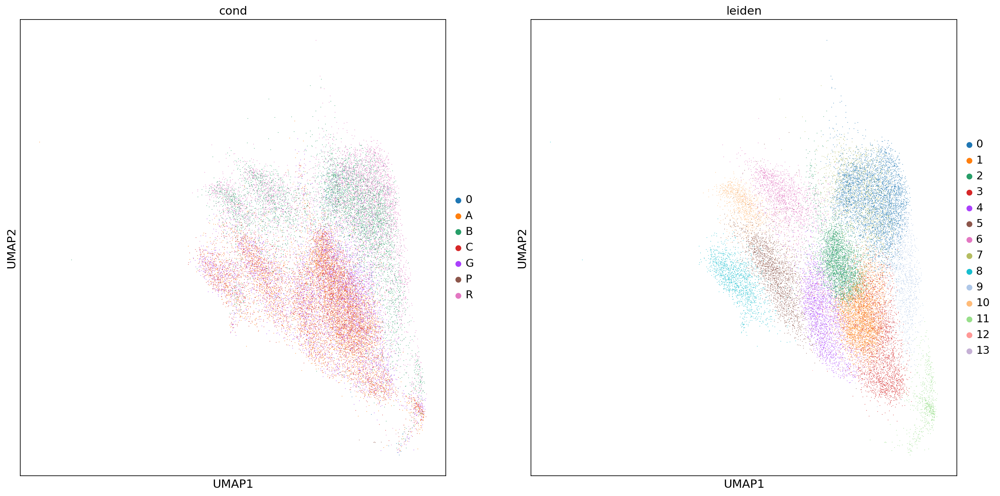

In [16]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['cond', 'leiden'], ax):
    sc.pl.umap(hi_mito,color=color, ax=ax, show=False, return_fig=False, size=2)

Sub-cluster some sub-clusters further to get the split I want. Cluster 11 I know is made up _very_ high mito cells solely from well 7 (number 8, last one on the chip). I'm just going to drop those probably anyway.

In [20]:
acg_hi_mito = [1, 2, 3, 4, 5, 8, 12, 13]
other_hi_mito = [0, 6, 7, 9, 10, 11]

In [21]:
ctdict = dict()
ctdict['acg_hi_mito'] = acg_hi_mito
ctdict['other_hi_mito'] = other_hi_mito
hi_mito.obs['acg_vs_other'] = hi_mito.obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        hi_mito.obs['acg_vs_other'].replace(str(clust), ct, regex=True, inplace=True)
hi_mito.obs['acg_vs_other'] = hi_mito.obs['acg_vs_other'].astype('category')

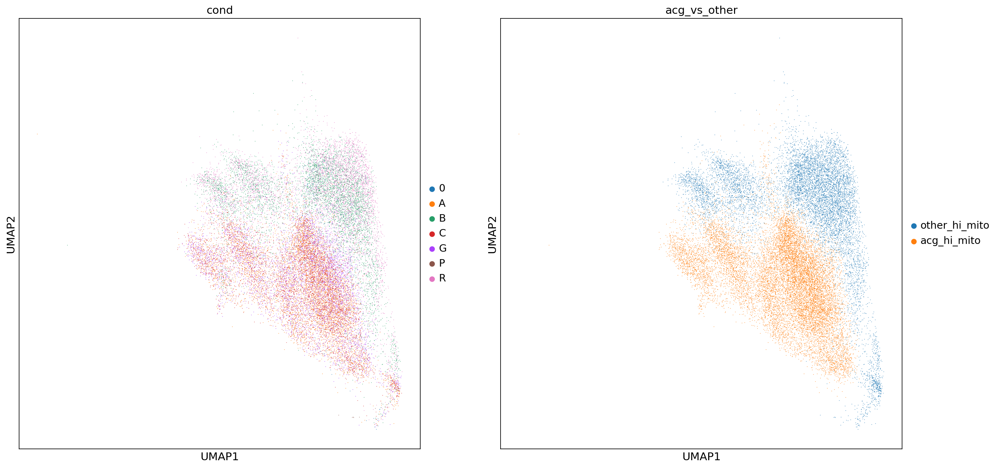

In [22]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['cond', 'acg_vs_other'], ax):
    sc.pl.umap(hi_mito, color=color, ax=ax, show=False, return_fig=False, size=2)

Beautiful. I now just want the cell barcodes becuase I want to run the processing pipeline from raw counts, so that when I find something that works, I can repeat for the whole batch of cells we have.

In [23]:
acg_hi_mito_bcs = hi_mito[hi_mito.obs['acg_vs_other'] == 'acg_hi_mito'].obs_names.values

In [24]:
acg_lo_mito_bcs = tnk['adata'][tnk['adata'].obs['mito'] == 'lo'].obs_names.values

### RE-RUN NEXT 4 CELLS TO RUN A NEW TRY OF MITO ACCOUNTING

In [56]:
hi_mito_path = prefix + 'mrna/obs/combat/acg.hi.mito.txt'
lo_mito_path = prefix + 'mrna/obs/combat/acg.lo.mito.txt'

# with open(hi_mito_path, 'w') as file:
#     for i in acg_hi_mito_bcs:
#         file.write(i + '\n')

# with open(lo_mito_path, 'w') as file:
#     for i in acg_lo_mito_bcs:
#         file.write(i + '\n')
        
with open(hi_mito_path, 'r') as file:
    acg_hi_mito_bcs = [i.strip('\n') for i in file.readlines()]

with open(lo_mito_path, 'r') as file:
    acg_lo_mito_bcs = [i.strip('\n') for i in file.readlines()]

In [57]:
keep_bcs = np.concatenate((acg_hi_mito_bcs, acg_lo_mito_bcs))

In [58]:
path = '/data/codec/production.run/mrna/pkls/wells.sng.w_covars.pkl'

with open(path,'rb') as file:
    wells = pkl.load(file)

In [59]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

### A Joint Representation
First just going to run on only the cells we care about, just to make sure isolating them to extrapolate methods is a good idea. I want to see them cluster separately just as they do when there are other cell types present.

#### Concatenate

In [8]:
concat = dict()

In [9]:
concat['adata'] = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1,12)]) # I really shouldn't do this, I should go back and run cellranger aggr, but for now just concatenate

In [10]:
concat['adata'].var['n_counts'] = concat['adata'].var[[i for i in concat['adata'].var.columns if i.startswith('n_counts')]].sum(axis=1)

In [11]:
concat['raw'] = concat['adata'].copy()

In [12]:
concat['adata'] = concat['adata'][keep_bcs,:].copy()
concat['raw'] = concat['raw'][keep_bcs,:].copy()

In [13]:
def process(adata):
    # remove any genes that are now empty
    sc.pp.filter_genes(adata, min_counts=100, inplace=True)
    sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e6)
    sc.pp.log1p(adata)
    return adata

In [14]:
concat['adata'] = process(concat['adata'])

filtered out 5953 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


#### Dimensionality Reduction, Visualization and Clustering

In [15]:
sc.pp.scale(concat['adata'])

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


In [17]:
warnings.filterwarnings('ignore')
sc.pp.combat(concat['adata'], key='batch',covariates=['cond','free_id'])
warnings.filterwarnings('default')

... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data



computing PCA with n_comps = 100
    finished (0:12:37)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


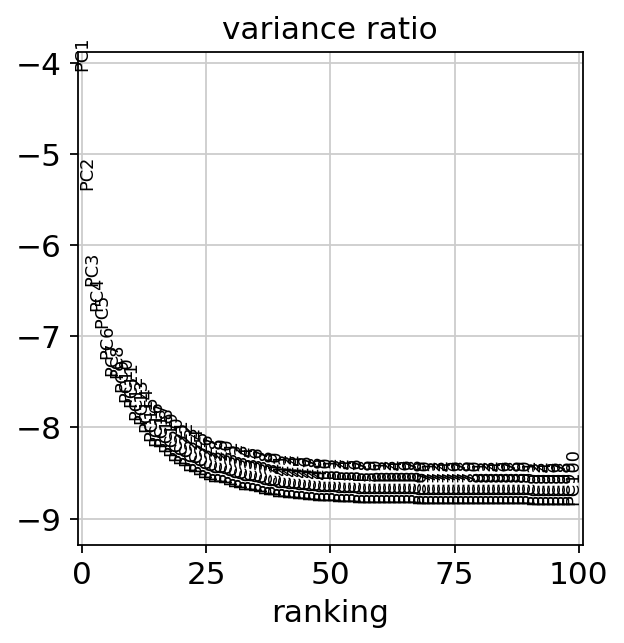

In [18]:
warnings.filterwarnings('ignore')
sc.pp.pca(concat['adata'],n_comps=100)
sc.pl.pca_variance_ratio(concat['adata'],log=True, n_pcs=100)
warnings.filterwarnings('default')

In [19]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(concat['adata'],n_neighbors=15,n_pcs=50) # using all available embeddings, numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:24)
    computed connectivities (0:00:04)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:29)


In [20]:
sc.tl.umap(concat['adata'])

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:09)


In [21]:
sc.tl.leiden(concat['adata'],resolution=0.5)

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:35)


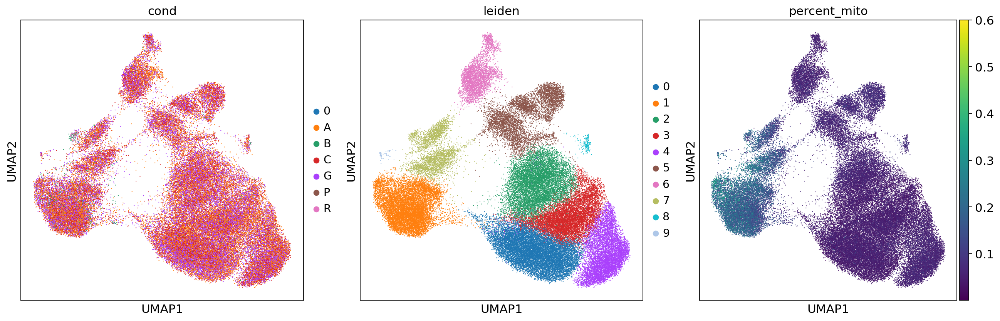

In [23]:
fig, ax = plt.subplots(1, 3, figsize=(20,6))
for color, ax in zip(['cond', 'leiden', 'percent_mito'], ax):
    sc.pl.umap(concat['adata'],color=color, ax=ax, show=False, return_fig=False, size=4)

Looks good, doesn't look like having other cells there matters: UMAp and Leiden are still separating them out as clearly two different sets of cells.

### Try 1: \[SKIPPED] Regress out Percent Mito
In this `combat()` version of this notebook, I'm going to skip this attempt because I really don't think it's going to help all that much. All the code was merged, commented out and collapsed below in case I feel like running it again.

In [50]:
# concat['adata'] = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1,12)]) # I really shouldn't do this, I should go back and run cellranger aggr, but for now just concatenate

# concat['adata'].var['n_counts'] = concat['adata'].var[[i for i in concat['adata'].var.columns if i.startswith('n_counts')]].sum(axis=1)

# concat['raw'] = concat['adata'].copy()

# concat['adata'] = concat['adata'][keep_bcs,:].copy()
# concat['raw'] = concat['raw'][keep_bcs,:].copy()

# concat['adata'] = process(concat['adata'])

# sc.pp.regress_out(concat['adata'], keys='percent_mito')

# sc.pp.scale(concat['adata'])

# warnings.filterwarnings('ignore')
# sc.pp.pca(concat['adata'],n_comps=100)
# sc.pl.pca_variance_ratio(concat['adata'],log=True, n_pcs=100)
# warnings.filterwarnings('default')

# warnings.filterwarnings('ignore')
# sc.pp.neighbors(concat['adata'],n_neighbors=15,n_pcs=50) # numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
# warnings.filterwarnings('default')

# sc.tl.umap(concat['adata'])

# sc.tl.leiden(concat['adata'],resolution=0.5)

# fig, ax = plt.subplots(1, 3, figsize=(20,6))
# for color, ax in zip(['cond', 'leiden','percent_mito'], ax):
#     sc.pl.umap(concat['adata'],color=color, ax=ax, show=False, return_fig=False, size=4)

# concat.keys()

# fig, ax = plt.subplots(1, 3, figsize=(20,6))
# for color, ax in zip(['CD4', 'CD3D','CD8A'], ax):
#     sc.pl.umap(concat['adata'],color=color, ax=ax, show=False, return_fig=False, size=4)

# path = '/data/codec/production.run/mrna/pkls/mito/try1.pkl'

# with open(path,'wb') as file:
#     pkl.dump(concat, file)
    
# # with open(path,'rb') as file:
# #     concat = pkl.load(file)

### Try 2: Ingest
I'm liking the idea of treating the high and low mito cells as two separate batches of cells. Batch correction is basically trying to do just that: find corresponding cell types between two sets of data and make them align better. I think we can justify doing this in the actual paper, especially considering how very clear the one-to-one mapping of cell types is between the high and low mito populations. 

I'm going to first remove the _very_ high mito cells. Then, I'm going to regress out the mito seperatley; I feel like this will work better then running regress mito on all of them together because when they're together, it's basically a Gaussian mixture, whereas once separated theyre each their own Gaussian. Actually pretty cool to think about dim reduction and clustering as a (probably overkill) tool for separating out the Gaussians from a mixture.  In any case, after mito regressino, I will run dim reduction an just the low mito cells and use ingest to fit the high mito data to the low mito projection.

In [8]:
concat = dict()

In [9]:
concat['adata'] = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1,12)]) # I really shouldn't do this, I should go back and run cellranger aggr, but for now just concatenate

In [10]:
concat['adata'].var['n_counts'] = concat['adata'].var[[i for i in concat['adata'].var.columns if i.startswith('n_counts')]].sum(axis=1)

In [11]:
concat['raw'] = concat['adata'].copy()

In [12]:
lo_mito = concat['adata'][acg_lo_mito_bcs,:].copy()
hi_mito = concat['adata'][acg_hi_mito_bcs,:].copy()

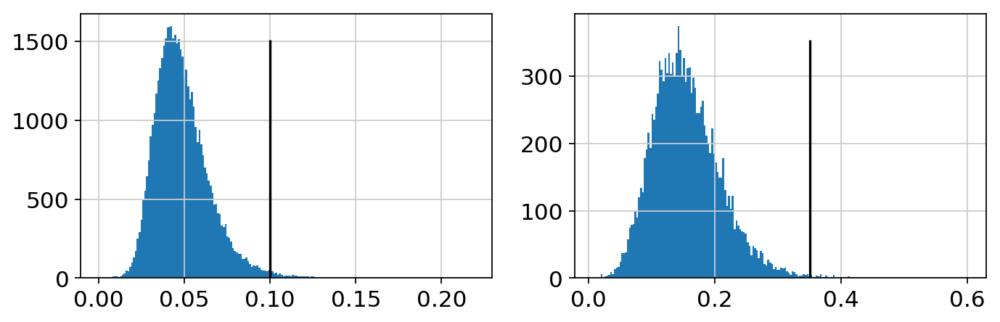

In [13]:
fig, ax = plt.subplots(1,2,figsize=(10,3))
for adata, thresh, ax in zip([lo_mito, hi_mito], [0.1, 0.35], ax):
    ax.hist(adata.obs['percent_mito'].values,bins=200);
    ax.vlines(thresh, 0, ax.get_ylim()[1]*0.9)

In [16]:
def process(adata, mito_thresh):
    # remove any genes that are now empty
    adata = adata[adata.obs['percent_mito'] < mito_thresh].copy()
    sc.pp.filter_genes(adata, min_counts=100, inplace=True)
    sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e6)
    sc.pp.log1p(adata)
    
    # I've always had trouble with scanpy respecting the n_jobs parameter for this function
    # Regardless of what I set 'sc.settings.n_jobs' to or if I input n_jobs=1 here,
    # It seems to use 8 cores at 100%, but if I increase this input to 16 for all cores on my machine
    # It uses basically 0%, it doesn't even look like its running anything
    
    sc.pp.regress_out(adata, keys='percent_mito', n_jobs=1)
    return adata

In [17]:
lo_mito = process(lo_mito, 0.1)
hi_mito = process(hi_mito, 0.35)

filtered out 6262 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
regressing out percent_mito
    sparse input is densified and may lead to high memory use


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


    finished (0:10:19)
filtered out 9986 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
regressing out percent_mito
    sparse input is densified and may lead to high memory use


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


    finished (0:01:51)


In [18]:
data = dict()
data['lo_mito'] = lo_mito
data['hi_mito'] = hi_mito

In [19]:
path = prefix + 'mrna/pkls/combat/mito/try2.1.pkl'

# with open(path,'wb') as file:
#     pkl.dump(data, file)
    
with open(path,'rb') as file:
    data = pkl.load(file)

### Dimensionality Reduction, Visualization and Clustering

In [20]:
sc.pp.scale(lo_mito)

In [22]:
warnings.filterwarnings('ignore')
sc.pp.combat(lo_mito, key='batch',covariates=['cond','free_id'])
warnings.filterwarnings('default')

Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data



computing PCA with n_comps = 100
    finished (0:08:29)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


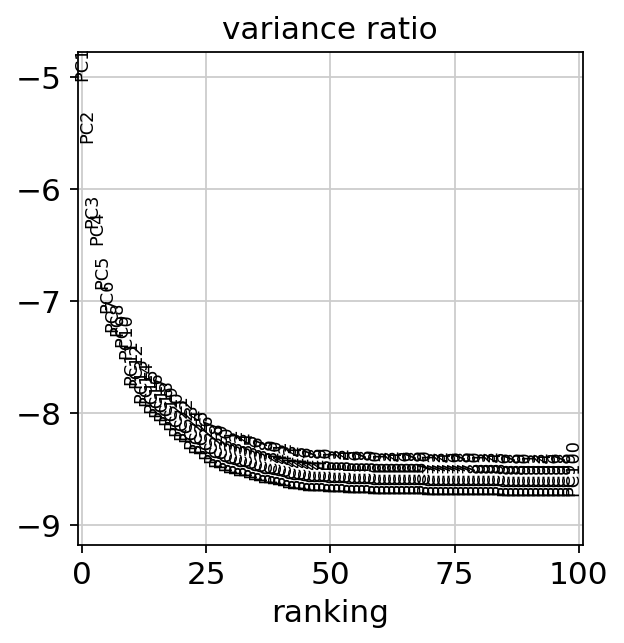

In [23]:
warnings.filterwarnings('ignore')
sc.pp.pca(lo_mito, n_comps=100)
sc.pl.pca_variance_ratio(lo_mito, log=True, n_pcs=100)
warnings.filterwarnings('default')

In [24]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(lo_mito, n_neighbors=15, n_pcs=50) # using all available embeddings, numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:21)
    computed connectivities (0:00:04)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:25)


In [25]:
sc.tl.umap(lo_mito)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:52)


In [26]:
sc.tl.leiden(lo_mito, resolution=0.5)

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:44)


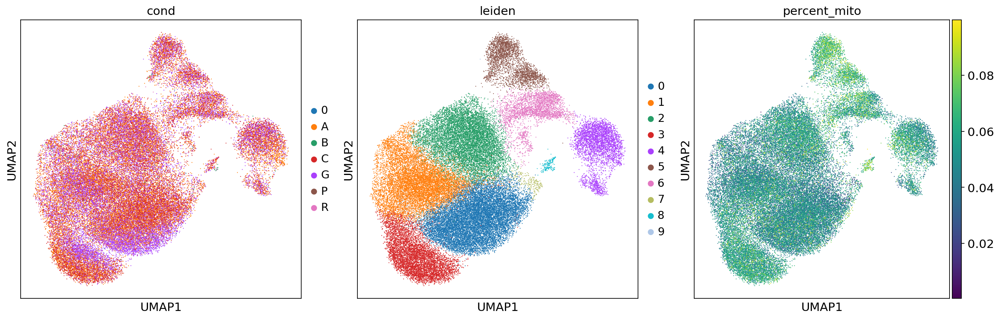

In [27]:
fig, ax = plt.subplots(1, 3, figsize=(20,6))
for color, ax in zip(['cond', 'leiden','percent_mito'], ax):
    sc.pl.umap(lo_mito, color=color, ax=ax, show=False, return_fig=False, size=4)

Ledien cluster 8 is interesting; I don't see anything that looks like it in the dim reduction run of all cells from all batches, but its showing up when I just run dim reduction on these cells alone. It looks like doublets, but why aren't I seeing it when I dim reduce and visualize on the full dataset? I should maybe explore that more later.

In [28]:
common_vars = np.intersect1d(lo_mito.var_names.values, hi_mito.var_names.values, assume_unique=False)

In [29]:
lo_mito = lo_mito[:, common_vars].copy()
hi_mito = hi_mito[:, common_vars].copy()

In [30]:
warnings.filterwarnings('ignore')
sc.tl.ingest(hi_mito, lo_mito, inplace=True)
warnings.filterwarnings('default')

running ingest
    finished (0:00:14)


In [9]:
acg_concat = lo_mito.concatenate(hi_mito)

... storing 'leiden' as categorical


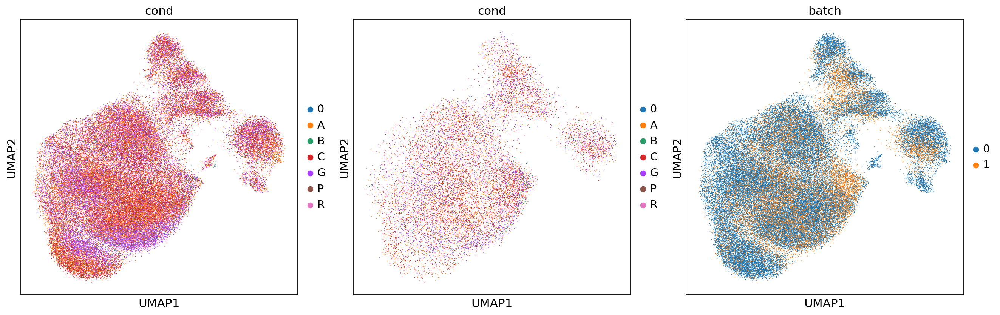

In [10]:
fig, ax = plt.subplots(1,3,figsize=(20,6))
for adata, ax, color in zip([acg_concat, hi_mito, acg_concat], ax, ['cond', 'cond', 'batch']):
    sc.pl.umap(adata,color=color, ax=ax,show=False,return_fig=False,size=3)

That is awesome, ingest works really well, though it definitely can't ascribe some cells to some populations, namely leiden cluster 8, and parts of 4 and 6. And while this is great to generate a joint projection, what might be problematic for us is that this **doesn't change the underlying data**. This isn't so much a batch correction method as it is a joint projection method. What this means is that, even if I cluster these cells, my high mito cells won't suddenly start clustering with the low mito ones. 

So I'll keep this projection becuase maybe we'll want to use it later, and I think this shows the batch correction approach has some promise, but I'll keep trying with something that actually change the underlying count data.

In [37]:
data['lo_mito'] = lo_mito
data['hi_mito'] = hi_mito

In [6]:
path = prefix + 'mrna/pkls/combat/mito/try2.2.pkl'

# with open(path,'wb') as file:
#     pkl.dump(data, file)
    
with open(path,'rb') as file:
    data = pkl.load(file)

lo_mito = data['lo_mito']
hi_mito = data['hi_mito']

### Try 3: \[SKIPPED] Combat
In this `combat()` version of this notebook, I'm going to skip this attempt because I really don't think it's going to help all that much. All the code was merged, commented out and collapsed below in case I feel like running it again.

In [4]:
# path = '/data/codec/production.run/mrna/pkls/mito/try2.1.pkl'

# # with open(path,'wb') as file:
# #     pkl.dump(data, file)
    
# with open(path,'rb') as file:
#     data = pkl.load(file)

# acg_concat = data['lo_mito'].concatenate(data['hi_mito'])

# sc.pp.combat(acg_concat,key='batch')

# ### Dimensionality Reduction, Visualization and Clustering

# sc.pp.scale(acg_concat)

# warnings.filterwarnings('ignore')
# sc.pp.pca(acg_concat, n_comps=100)
# sc.pl.pca_variance_ratio(acg_concat, log=True, n_pcs=100)
# warnings.filterwarnings('default')

# warnings.filterwarnings('ignore')
# sc.pp.neighbors(acg_concat, n_neighbors=15, n_pcs=50) # using all available embeddings, numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
# warnings.filterwarnings('default')

# sc.tl.umap(acg_concat)

# sc.tl.leiden(acg_concat, resolution=0.5)

# fig, ax = plt.subplots(1, 4, figsize=(27,6))
# for color, ax in zip(['cond', 'leiden', 'batch', 'percent_mito'], ax):
#     sc.pl.umap(acg_concat, color=color, ax=ax, show=False, return_fig=False, size=4)

# fig, ax = plt.subplots(1, 4, figsize=(27,6))
# for color, ax in zip(['CD3E', 'FCGR3A', 'CD4', 'CD8A'], ax):
#     sc.pl.umap(acg_concat, color=color, ax=ax, show=False, use_raw=False, return_fig=False, size=4)

# path = '/data/codec/production.run/mrna/pkls/mito/try3.pkl'

# # with open(path,'wb') as file:
# #     pkl.dump(acg_concat, file, protocol=4)
    
# with open(path,'rb') as file:
#     acg_concat = pkl.load(file)

### Try 4: \[SKIPPED] Protein
In this `combat()` version of this notebook, I'm going to skip this attempt because I really don't think it's going to help all that much. All the code was merged, commented out and collapsed below in case I feel like running it again.

In [22]:
# path = prefix + '/adts/pkls/concat.adts.norm.log.pkl'

# # with open(path,'wb') as file:
# #     pkl.dump(concat_adts, file)
    
# with open(path,'rb') as file:
#     concat_adts = pkl.load(file)

# hi_mito_path = '/data/codec/production.run/mrna/obs/acg.hi.mito.txt'
# lo_mito_path = '/data/codec/production.run/mrna/obs/acg.lo.mito.txt'

# with open(hi_mito_path, 'r') as file:
#     acg_hi_mito_bcs = [i.strip('\n') for i in file.readlines()]

# with open(lo_mito_path, 'r') as file:
#     acg_lo_mito_bcs = [i.strip('\n') for i in file.readlines()]

# batch_1 = concat_adts['adata'][acg_lo_mito_bcs,:].copy()
# batch_2 = concat_adts['adata'][acg_hi_mito_bcs,:].copy()

# acg = batch_1.concatenate(batch_2)

# warnings.filterwarnings('ignore')
# sc.pp.pca(acg,n_comps=100)
# sc.pl.pca_variance_ratio(acg,log=True, n_pcs=100)
# warnings.filterwarnings('default')

# warnings.filterwarnings('ignore')
# sc.pp.neighbors(acg,n_neighbors=15) # use .X because all the surface markers we're looking at are probably pretty important
# warnings.filterwarnings('default')

# sc.tl.umap(acg)

# sc.tl.leiden(acg,resolution=0.4)

# sc.pl.umap(acg, color=['leiden', 'batch'])

# sc.pl.umap(acg, color=['CD4|CD4', 'CD8|CD8A','CD3|CD3E','CD56|NCAM1'])

### Try 5: \[SKIPPED] Regress Out Mito PCs
In this `combat()` version of this notebook, I'm going to skip this attempt because I really don't think it's going to help all that much. 

### Try 6: MNN

Okay, reading more about MNN, I think it's exactly what we need. It takes in an input list of features and basically I think it only corrects according to those features. So we can just take the most important features from the data and just use those, i.e. not mitochondrial genes. The docstring for this function recommends not using the corrected matrix for differential expression analysis, and despite not knowing where the evidence is to support that recommendation, I can understand why they would make this recommendation. Howwever, I should find out where the evidence is for this recommendation because the idea of recovering those cells would be to use it for eQTL analysis and my guess is that if we can't use it for differential expression we probably shouldn't be able to use it for eQTL analysis either, but maybe we can make the exception because they're not actually separate batches but rather different cells from the same exact batch and individuals.

In [4]:
path = prefix + 'mrna/pkls/combat/mito/try2.2.pkl'
    
with open(path,'rb') as file:
    data = pkl.load(file)

In [71]:
hi_mito = data['hi_mito']

In [73]:
sc.pp.scale(hi_mito)

In [74]:
warnings.filterwarnings('ignore')
sc.pp.combat(hi_mito, key='batch',covariates=['cond','free_id'])
warnings.filterwarnings('default')

Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data



computing PCA with n_comps = 100
    finished (0:01:30)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


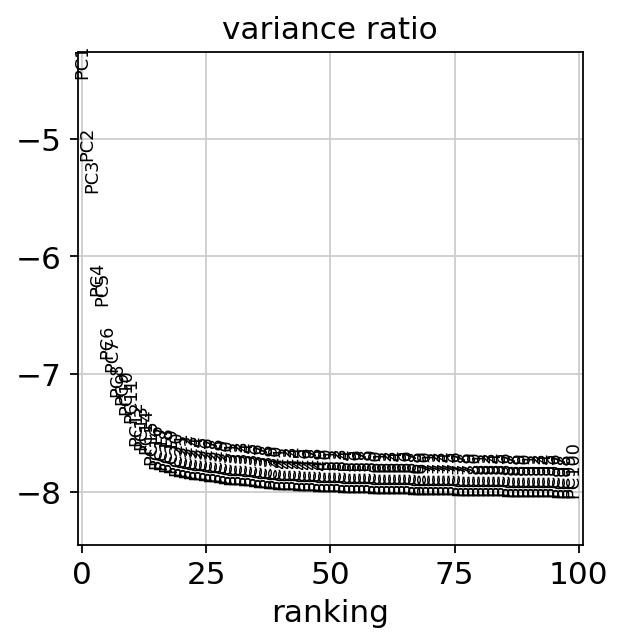

In [75]:
warnings.filterwarnings('ignore')
sc.pp.pca(hi_mito, n_comps=100)
sc.pl.pca_variance_ratio(hi_mito, log=True, n_pcs=100)
warnings.filterwarnings('default')

In [77]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(hi_mito, n_neighbors=15, n_pcs=20) # using all available embeddings, numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    using 'X_pca' with n_pcs = 20
    computed neighbors (0:00:04)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:04)


In [79]:
sc.tl.umap(hi_mito)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:14)


In [80]:
sc.tl.leiden(hi_mito, resolution=0.3)

running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


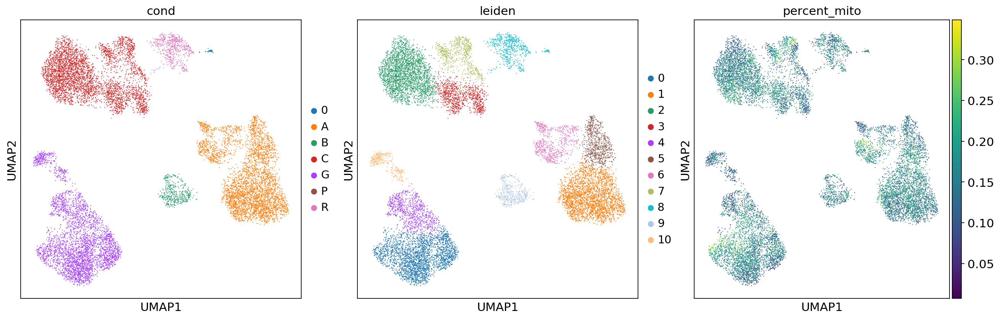

In [81]:
fig, ax = plt.subplots(1, 3, figsize=(20,6))
for color, ax in zip(['cond', 'leiden', 'percent_mito'], ax):
    sc.pl.umap(hi_mito, color=color, ax=ax, show=False, return_fig=False, size=4)

In [82]:
hi_mito.raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1,12)])[hi_mito.obs_names].copy()

ranking genes
    consider 'leiden' groups:
    with sizes: [2815 2812 2748  958  892  793  733  719  645  454  363]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:17)


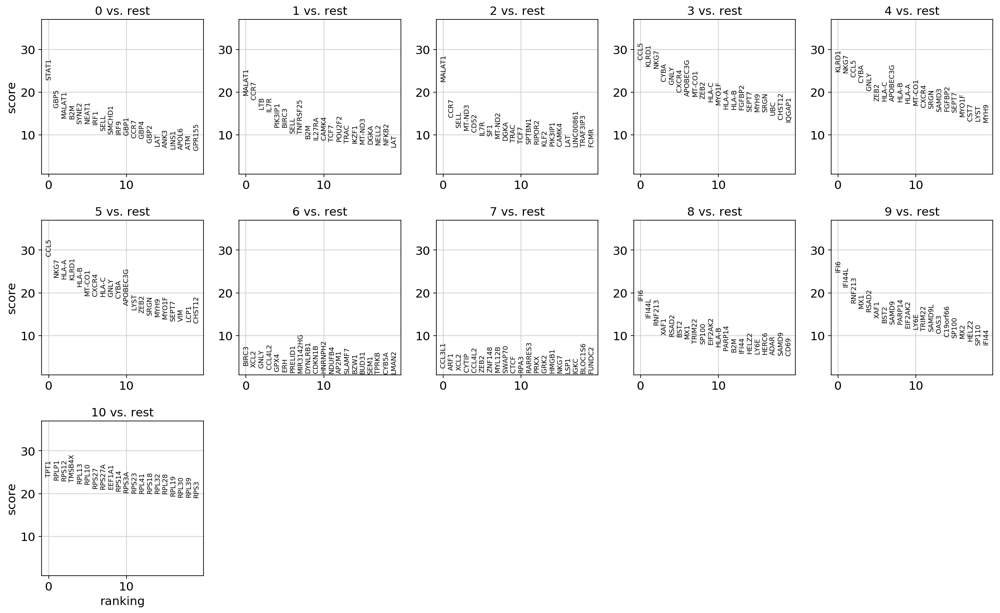

In [83]:
# sc.settings.verbosity = 0 
# warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(hi_mito, groupby='leiden', n_genes=50, use_raw=True, method='wilcoxon')
# warnings.filterwarnings('default')
sc.pl.rank_genes_groups(hi_mito, ncols=5, n_genes=20)
# sc.settings.verbosity = 4

ranking genes
    consider 'leiden' groups:
    with sizes: [ 719 2748]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


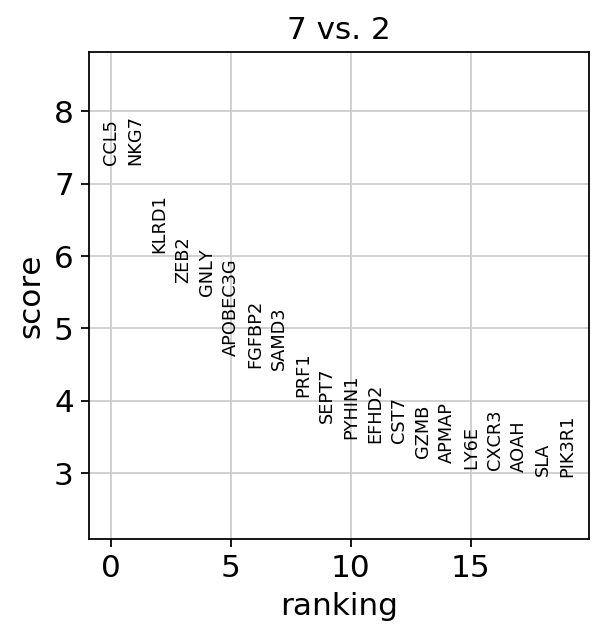

In [84]:
# sc.settings.verbosity = 0 
# warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(hi_mito, groupby='leiden', n_genes=50, use_raw=True, method='wilcoxon', groups=['7'], reference='2')
# warnings.filterwarnings('default')
sc.pl.rank_genes_groups(hi_mito, ncols=5, n_genes=20)
# sc.settings.verbosity = 4

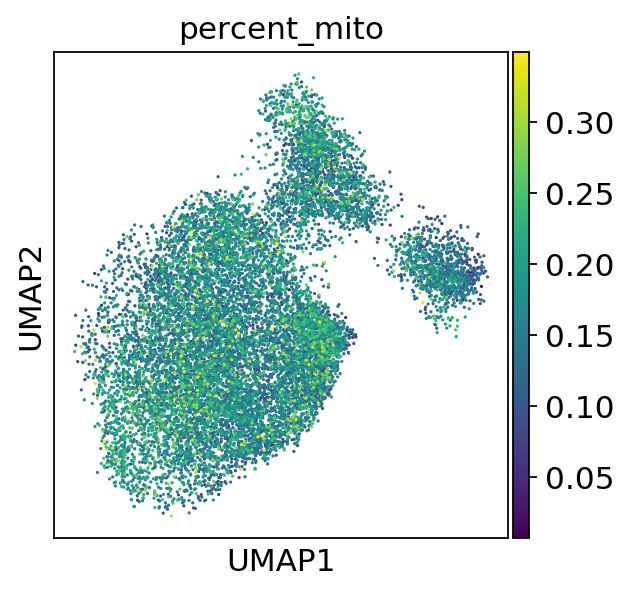

In [70]:
sc.pl.umap(data['hi_mito'],color=['percent_mito'])

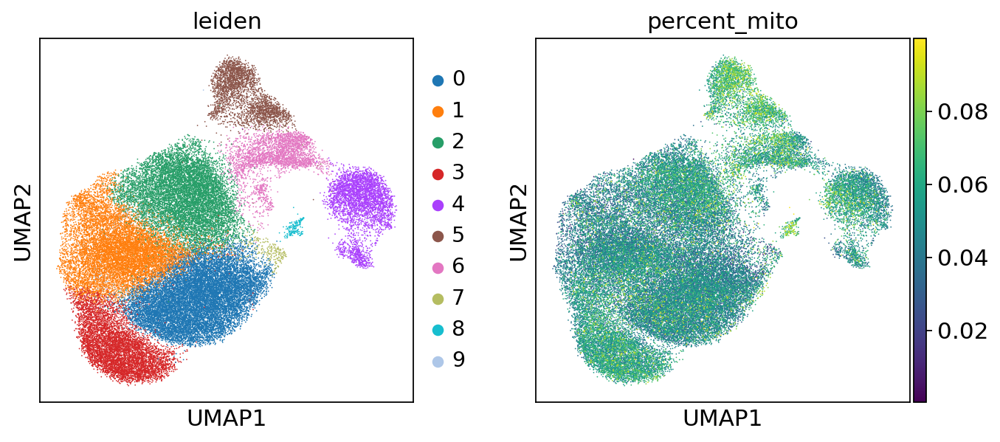

In [5]:
sc.pl.umap(data['lo_mito'],color=['leiden', 'percent_mito'])

In [6]:
sub_adatas = dict() # put the new subsetted adata objects in a dictionary of adatas
sub_adatas['4'] = data['lo_mito'][data['lo_mito'].obs['leiden'] == '4'].copy()
sub_adatas['5'] = data['lo_mito'][data['lo_mito'].obs['leiden'] == '5'].copy()
sub_adatas['6'] = data['lo_mito'][data['lo_mito'].obs['leiden'] == '6'].copy()

running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


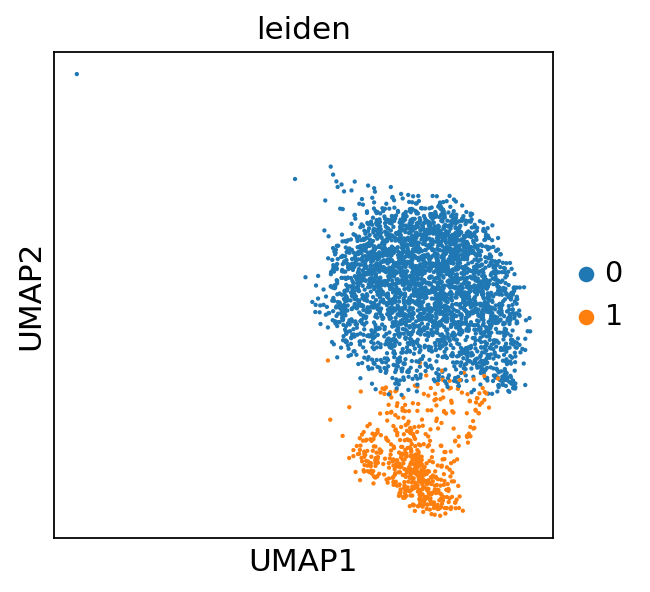

In [7]:
sc.tl.leiden(sub_adatas['4'], resolution=0.2) # subcluster them using Leiden
sc.pl.umap(sub_adatas['4'], color='leiden', size=15)

running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


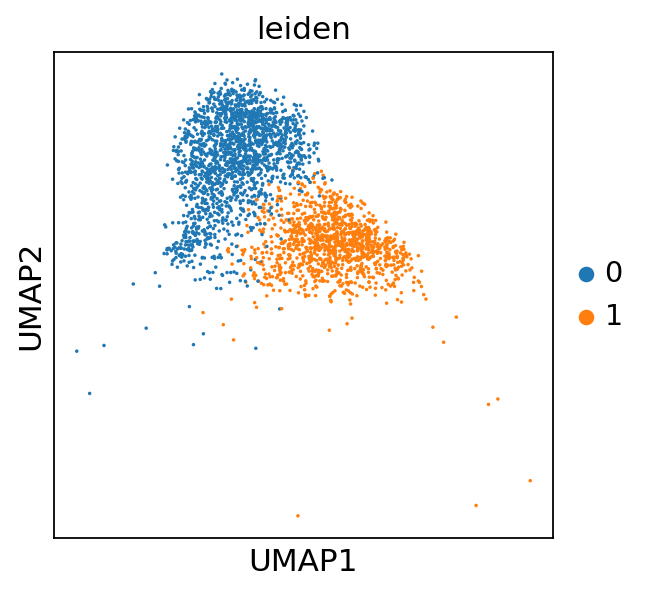

In [8]:
sc.tl.leiden(sub_adatas['5'], resolution=0.2) # subcluster them using Leiden
sc.pl.umap(sub_adatas['5'], color='leiden', size=10)

running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


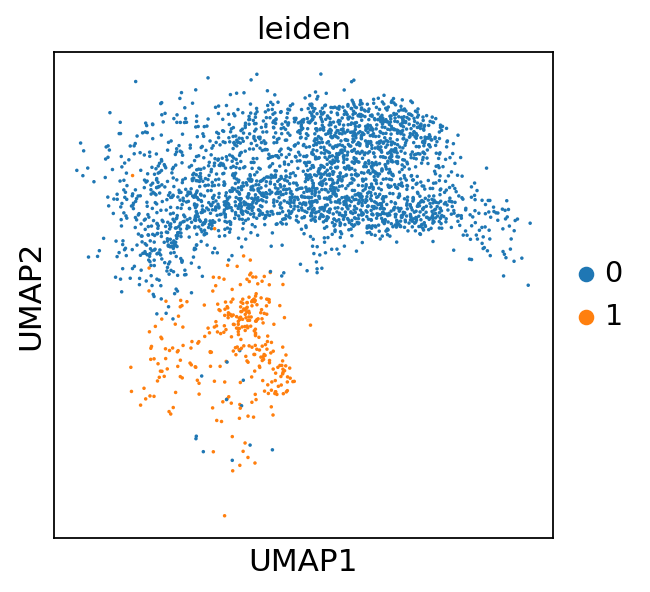

In [9]:
sc.tl.leiden(sub_adatas['6'], resolution=0.1) # subcluster them using Leiden
sc.pl.umap(sub_adatas['6'], color='leiden', size=10)

Map them back to the clusters on the original adata

In [10]:
def sub_cluster_mapper(adata, sub_adatas):
    '''
    This takes in the adata object and inserts a new leiden column in the `.obs`. 
    
    This function is really convoluted and there's probably a better, simpler way to do it,
    but it should theoretically work for any number of subclusters
    '''
    # ideally you'd make a copy of the adata object here, so we don't have to change the original
    # this would be in case we want to run it multiple times, perhaps the resolutions we put in didn't subset the clusters like we had hoped
    # and we need to run multiple times to adjust the resolution slightly
    
    # this block is to figure out that there are two new subclusters and they should be named 8, 9
    total_new_clusts = 0
    old_clusts = sub_adatas.keys()
    for sub_adata in sub_adatas:
        total_new_clusts += sub_adatas[sub_adata].obs['leiden'].astype(int).unique().max() + 1
    total_added_clusts = total_new_clusts - len(sub_adatas)
    new_clust_names_start = max(adata.obs['leiden'].astype(int))+1
    new_added_clust_names = [str(i) for i in range(new_clust_names_start,
                                                   new_clust_names_start + total_added_clusts)]
    
    # this block is to build a new list of leiden clusters from the old one 
    new_leiden = list()
    leiden_col = adata.obs['leiden'].copy()

    # this builds the new leiden cluster list, now adding a .1, .2, etc. to each new cluster
    for obs in leiden_col.index:
        clust_name = leiden_col.loc[obs]
        if clust_name not in old_clusts or sub_adatas[clust_name].obs.loc[obs, 'leiden'] == '0':
            new_leiden.append(clust_name)
        else:
            new_leiden.append(clust_name + '.%s' % sub_adatas[clust_name].obs.loc[obs,'leiden'])

    # this renames the .1, .2, etc clusters to the new, better names I came up with above (8 and 9)
    new_leiden = pd.Series(new_leiden, index=adata.obs_names)
    added_clusts = np.setdiff1d(new_leiden,adata.obs['leiden'])
    new_leiden.replace(dict(zip(added_clusts, new_added_clust_names)), inplace=True)
    
    # replace the old leiden column, must do these steps sequentially 
    adata.obs['leiden'] = new_leiden.astype(int) # to order the clusters by number
    adata.obs['leiden'] = new_leiden.astype(str) # to convert to string as normal
#     adata.obs['leiden'] = new_leiden.astype('category') # don't do this, it messes things up, just let scanpy do it as it plots
    return adata

In [11]:
data['lo_mito'] = sub_cluster_mapper(data['lo_mito'], sub_adatas)

In [60]:
data['lo_mito'].raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1,12)])[data['lo_mito'].obs_names].copy()

In [64]:
data['lo_mito'].raw

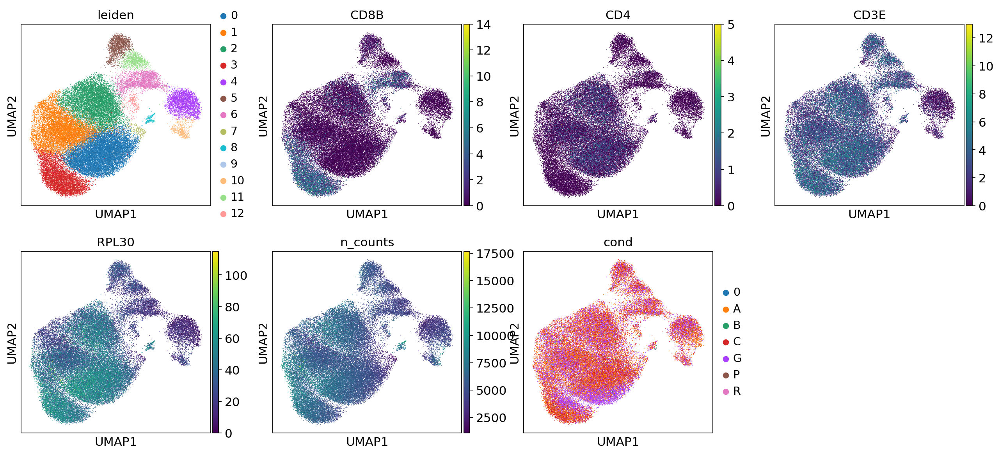

In [67]:
sc.pl.umap(data['lo_mito'], color=['leiden','CD8B','CD4','CD3E','RPL30', 'n_counts', 'cond'])

ranking genes
    consider 'leiden' groups:
    with sizes: [13545  9862  9605  6239  2987  1722  2531   234   170   123   548  1150
   301]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:19)


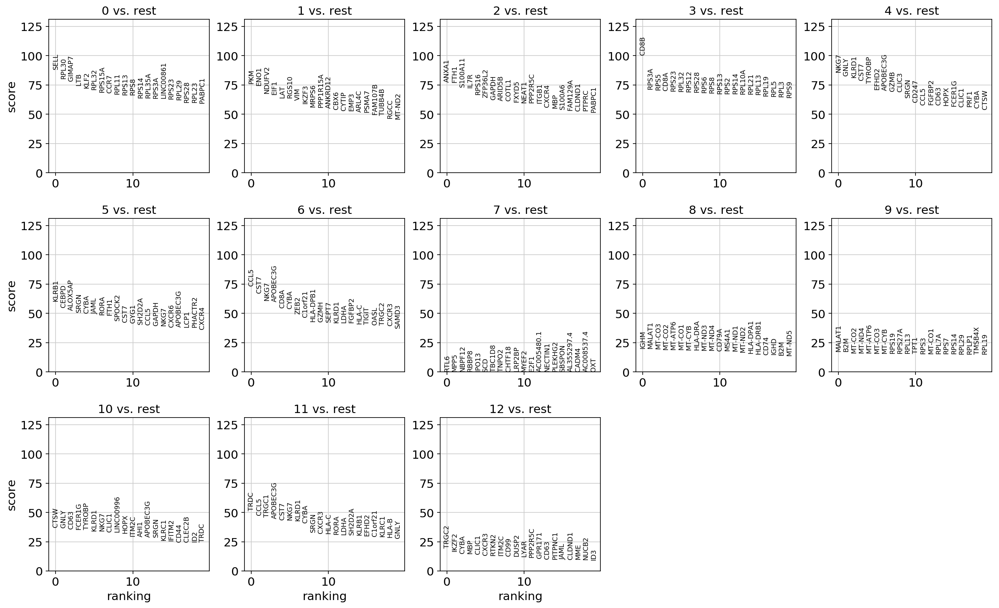

In [68]:
# sc.settings.verbosity = 0 
# warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(data['lo_mito'], groupby='leiden', n_genes=100, use_raw=True, method='wilcoxon')
# warnings.filterwarnings('default')
sc.pl.rank_genes_groups(data['lo_mito'], ncols=5, n_genes=20)
# sc.settings.verbosity = 4

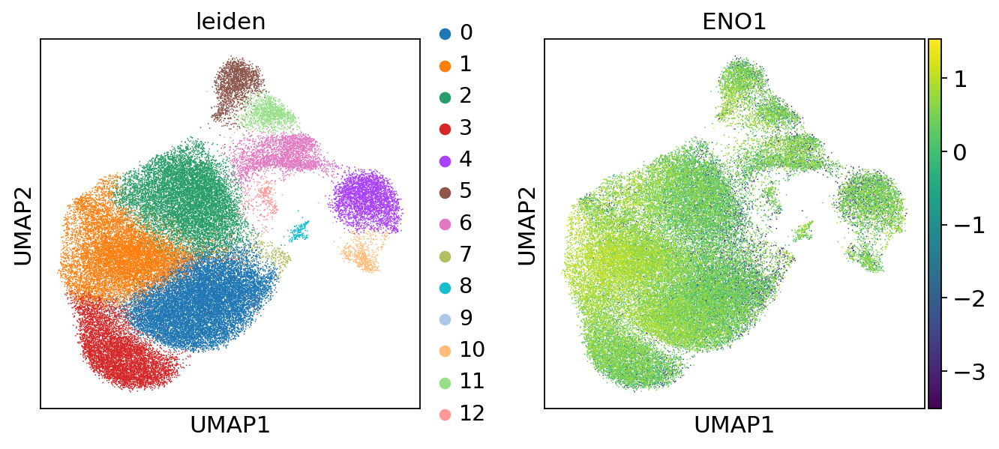

In [55]:
sc.pl.umap(data['lo_mito'], color=['leiden','ENO1'])

In [27]:
top50 = np.unique(np.array(data['lo_mito'].uns['rank_genes_groups']['names'].tolist())[:50,:].flatten())
top50 = np.array([i for i in set(top50) if not i.startswith('MT')])

In [29]:
path = prefix + 'mrna/var/combat/top50.txt'

# with open(path, 'w') as file:
#     for i in top50:
#         file.write(i + '\n')

with open(path,'r') as file:
    top50 = [i.strip() for i in file.readlines()]

Okay, after a lot of trial and error, uninstalling and reinstalling different versions of numba (and its dependencies llvmlite and tbb), anndata, and scanpy, I've figured out that the version of `mnnpy` found in Scanpy was having issues. I would see "Performing cosine normalization" but my machine looked like it wasn't running a single core, and this step would just hang indefinitely. I tried installing the `mnnpy` package directly (which looks like it was essentially _written_ for Scanpy, Scanpy's external module just has a very thin wrapper around it) and running it through `mnnpy`. The call to the function was almost exactly the same, and the same issues arose.

I found an issue on the `mnnpy` Github that related to this (just search for "Perform cosine normalization" on their issues page) and one of the solutions was to circumvent the `python multiprocessing` workflow with `mnnpy.settings.normalization='seq'`. Once doing this, it starts to actually use all my cores and moves on from the "Performing cosine normalization" step. 

In [33]:
warnings.filterwarnings('default')
import mnnpy
mnnpy.settings.normalization='seq'
warnings.filterwarnings('ignore')

In [54]:
corrected = mnnpy.mnn_correct(data['lo_mito'], data['hi_mito'], 
                                                var_subset=pd.Series(top50), 
                                                svd_dim = 50,
                                                batch_key = 'mito',
                                                batch_categories = ['lo','hi'])

Performing cosine normalization...
Starting MNN correct iteration. Reference batch: 0
Step 1 of 1: processing batch 1
  Looking for MNNs...


KeyboardInterrupt: 

In [51]:
mnnpy.mnn_correct(

SyntaxError: unexpected EOF while parsing (<ipython-input-51-d9d8510c8a2b>, line 1)

In [34]:
print(data['lo_mito'].shape)
print(data['hi_mito'].shape)

(49017, 10617)
(13932, 10617)


In [35]:
mnn = corrected[0]

In [36]:
mnn.shape

(62949, 10617)

computing PCA with n_comps = 100
    finished (0:02:43)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


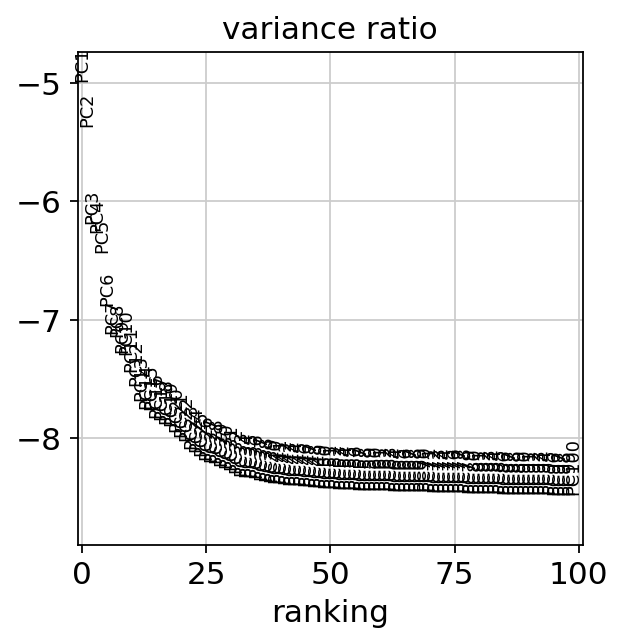

In [37]:
warnings.filterwarnings('ignore')
sc.pp.pca(mnn, n_comps=100)
sc.pl.pca_variance_ratio(mnn, log=True, n_pcs=100)
warnings.filterwarnings('default')

In [38]:
path = prefix + 'mrna/pkls/combat/mito/try6.1.pkl'

# with open(path,'wb') as file:
#     pkl.dump(mnn, file)
    
with open(path,'rb') as file:
    mnn = pkl.load(file)

In [39]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(mnn, n_neighbors=15, n_pcs=50)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:27)
    computed connectivities (0:00:05)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:33)


In [40]:
sc.tl.umap(mnn)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:14)


In [41]:
sc.tl.leiden(mnn, resolution=0.5)

running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:36)


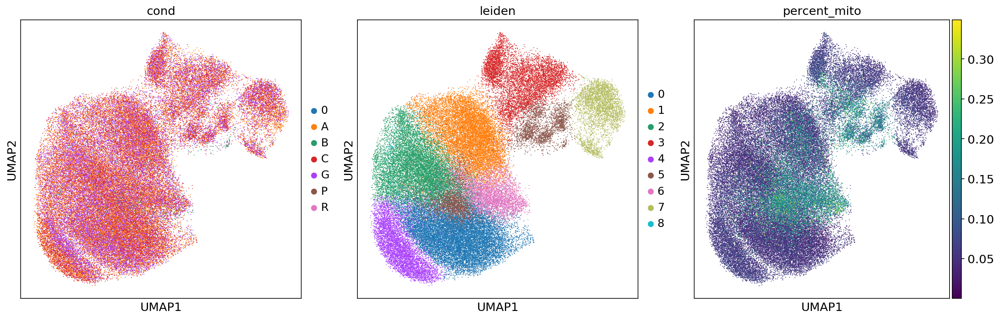

In [42]:
fig, ax = plt.subplots(1, 3, figsize=(20,6))
for color, ax in zip(['cond', 'leiden','percent_mito'], ax):
    sc.pl.umap(mnn, color=color, ax=ax, show=False, return_fig=False, size=4)

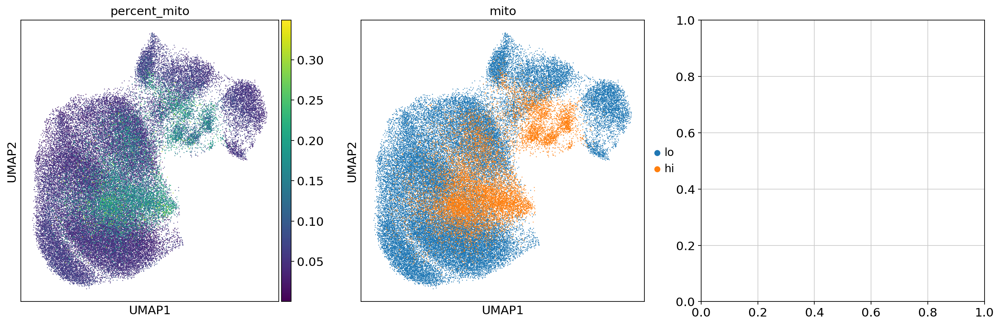

In [50]:
fig, ax = plt.subplots(1, 3, figsize=(20,6))
for color, ax in zip(['percent_mito', 'mito'], ax):
    sc.pl.umap(mnn, color=color, ax=ax, show=False, return_fig=False, size=4)

In [49]:
corrected[1][1]['original batch'].values

(array([0]), array([163660]))

In [18]:
fig, ax = plt.subplots(1, 3, figsize=(20,6))
for color, ax in zip(['cond', 'leiden','percent_mito', ], ax):
    sc.pl.umap(mnn, color=color, ax=ax, show=False, return_fig=False, size=4)

[0,         new cell  ref cell  original batch
 0              0     40447               0
 1              0     41142               0
 2              0     19115               0
 3              0        35               0
 4              0     19009               0
 ...          ...       ...             ...
 157722     13931     48120               0
 157723     13931      7149               0
 157724     13931     39168               0
 157725     13931     35715               0
 157726     13931     18482               0
 
 [157727 rows x 3 columns]]

In [14]:
# warnings.filterwarnings('ignore')
adata, dfs, angles = sc.external.pp.mnn_correct(data['lo_mito'], data['hi_mito'], 
                                                var_subset=top50, 
                                                svd_dim = 50, 
                                                batch_key = 'mito',
                                                batch_categories = ['lo','hi'],
                                               )
# warnings.filterwarnings('default')

Performing cosine normalization...


Process ForkPoolWorker-15:
Process ForkPoolWorker-16:
Process ForkPoolWorker-9:
Process ForkPoolWorker-5:
Process ForkPoolWorker-7:
Process ForkPoolWorker-6:
Process ForkPoolWorker-12:
Process ForkPoolWorker-10:
Process ForkPoolWorker-11:
Process ForkPoolWorker-8:
Process ForkPoolWorker-13:
Traceback (most recent call last):
Process ForkPoolWorker-14:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/ssm-user/anaconda3/envs/codec/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/home/ssm-user/anaconda3/envs/codec/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/home/ssm-user/anaconda3/envs/codec/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/home/ssm-user/anaconda3/envs/codec/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Tr

KeyboardInterrupt: 

## Highly Variable Genes

In [8]:
import matplotlib.patches as patches
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon

In [9]:
concat = dict()

In [10]:
concat['adata'] = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1,12)]) # I really shouldn't do this, I should go back and run cellranger aggr, but for now just concatenate

In [11]:
concat['adata'].var['n_counts'] = concat['adata'].var[[i for i in concat['adata'].var.columns if i.startswith('n_counts')]].sum(axis=1)

In [12]:
concat['raw'] = concat['adata'].copy()

In [13]:
lo_mito = concat['adata'][acg_lo_mito_bcs,:].copy()
hi_mito = concat['adata'][acg_hi_mito_bcs,:].copy()

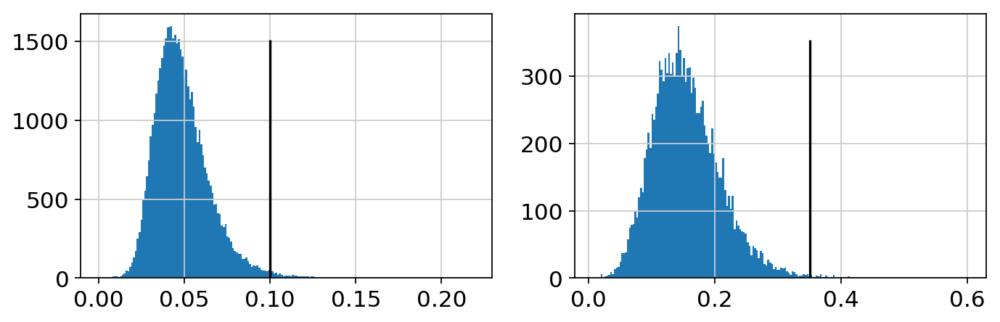

In [14]:
fig, ax = plt.subplots(1,2,figsize=(10,3))
for adata, thresh, ax in zip([lo_mito, hi_mito], [0.1, 0.35], ax):
    ax.hist(adata.obs['percent_mito'].values,bins=200);
    ax.vlines(thresh, 0, ax.get_ylim()[1]*0.9)

In [15]:
def process(adata):
    # remove any genes that are now empty
    sc.pp.filter_genes(adata, min_counts=100, inplace=True)
    sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e6)
    return adata

In [16]:
concat['adata'] = process(concat['adata'])

filtered out 2765 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:03): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [17]:
def hv_run(adata, flavor='cell_ranger', min_mean=0.0125, min_disp=0.5, max_mean=3, bins=500):    # Extract out highly variable genes, but don't subset just yet
    '''
    Run highly variable genes and return a new adata object, if provided.
    '''
    hv_adata = adata.copy() # make a copy because I don't want to change the original just yet
    sc.pp.highly_variable_genes(hv_adata, flavor=flavor,inplace=True, 
                                min_mean=min_mean, 
                                min_disp=min_disp, 
                                max_mean=max_mean,
                                n_bins=bins)
    
    means = hv_adata.var['means'].values
    means_sorted = np.unique(np.sort(means))
    if means_sorted[0] == 0:
        mean_shift = means_sorted[1]
    elif means_sorted[0] < 0:
        mean_shift = means_sorted[1] - 2*means_sorted[0]
    else:
        mean_shift = 0
    
    disps = hv_adata.var['dispersions_norm'].values
    disps_sorted = np.unique(np.sort(disps))
    if disps_sorted[0] == 0:
        disp_shift = disps_sorted[1]
    elif disps_sorted[0] < 0:
        disp_shift = disps_sorted[1] - 2*disps_sorted[0]
    else:
        disp_shift = 0
        
    log_means = np.log10(means + mean_shift)
    log_disps = np.log10(disps + disp_shift)
    
    hv_adata.var['log_means'] = log_means
    hv_adata.var['log_disps'] = log_disps
    
    return hv_adata

def hv_plot(hv_adata, gate=None, highlight_genes=None, jointplot=False):
    '''
    Plot the means and normalized dispersions from the adata object provided. Choose to
    also plot a gate or highlight certain genes.
    '''

    
    # do what the scanpy function does, plotting normalized dispersions with means as blue dots, 
    # I don't want to plot in logspace but I don't want to use the log function because then the gates don't work
    # if they contain segments with fractional slopes (i.e. non-straight lines). To be robust to these gates, I therefore 
    # will log10 everything and just plot in linear space
    log_means = hv_adata.var['log_means'].values
    log_disps = hv_adata.var['log_disps'].values
    
    if jointplot == True:
        sns.jointplot(log_means, y=log_disps, kind='kde', color="skyblue")
    
    plt.figure(figsize=(7,7)) # make a figure
    plt.minorticks_on() # throw on the minor ticks for use with the grid, will help with subsetting
    plt.grid(True,which='both',axis='both') # turn the grid on
    plt.scatter(log_means, log_disps, s=0.1, c='b')

    if type(highlight_genes) != type(None): # do you want to highlight some genes?
        mask = [i in highlight_genes for i in hv_adata.var_names] # create a boolean mask of which genes to highlight
        highlight_means = log_means[mask] # subset only those means
        highlight_disps = log_disps[mask] # subset only those dispersions
        plt.scatter(highlight_means,highlight_disps,s=30, facecolors='none', edgecolors='r'); # plot with a red circle around the blue dot
        
    if type(gate) != type(None):
        # You can draw a gate around the genes you want. There should be a check for using only rectangular gates (or only polygons with right angles). 
        # I have noted that if you try to draw angled lines in log space using the shapely package, the points_in_poly function does not return the right subset of points within the polygon.
        ax = plt.gca() # if you want to add a gate
        gatepatch = patches.Polygon(gate,linewidth=1,edgecolor='teal',facecolor='turquoise',alpha=0.5) # create a matplotlib patch for the gate to the plot
        ax.add_patch(gatepatch); # add the gate to the plot

def hv_genes(hv_adata, gate, adata=None):
    '''
    Receive boolean for genes in gate or new subsetted adata object, if provided.
    '''
    # You can subset the genes you want using the gate. Again, there should be a check for using only rectangular gates (or only polygons with right angles). 
    # I have noted that if you try to draw angled lines in log space using the shapely package, the points_in_poly function does not return the right subset of points within the polygon.
    genes = list()
    log_means = hv_adata.var['log_means'].values
    log_disps = hv_adata.var['log_disps'].values
    
    pointsmap = map(Point,log_means,log_disps) # make each point a shapely.geometry.Point
    
    polygon = Polygon(gate) # make your gate a shapely.geometry.Polygon
    for i in pointsmap:
        genes.append(polygon.contains(i)) # this is the workhorse, determining which points are in the gate
    if type(adata) != type(None): # if the adata has been provided, subset it
        adata = adata[:,genes].copy()
        return adata
    else: # if it has not been provided return the boolean array noting which genes will be kept
        return genes

In [18]:
hv_adata = hv_run(concat['adata'])

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


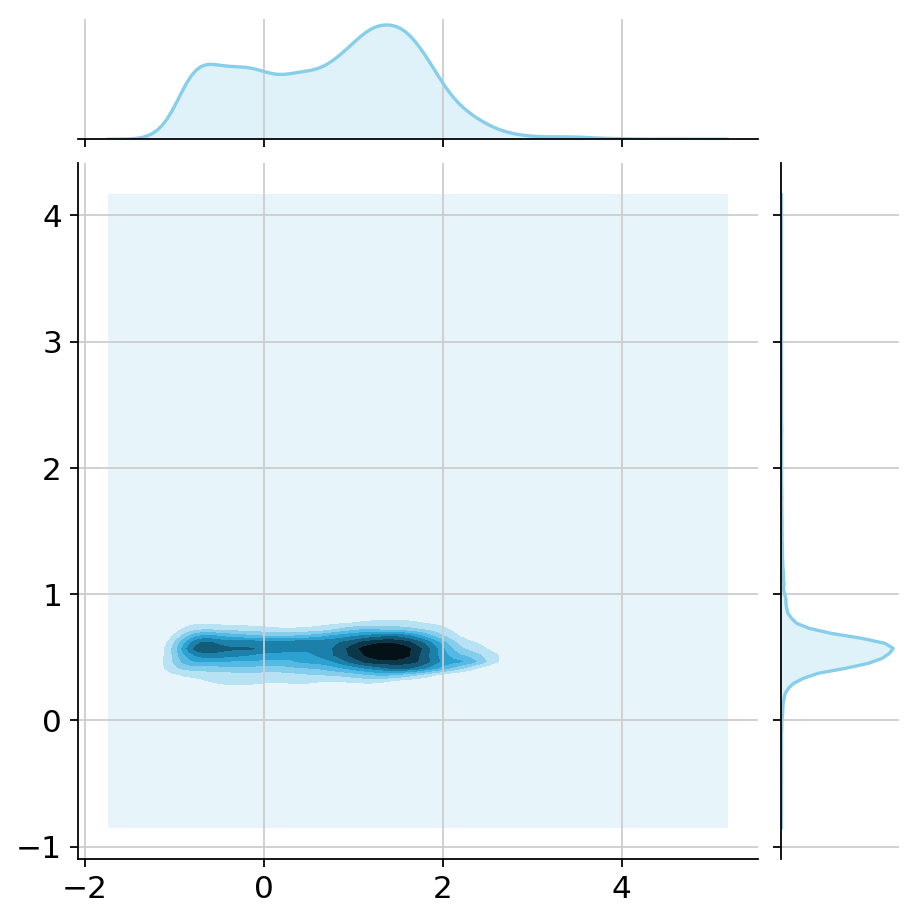

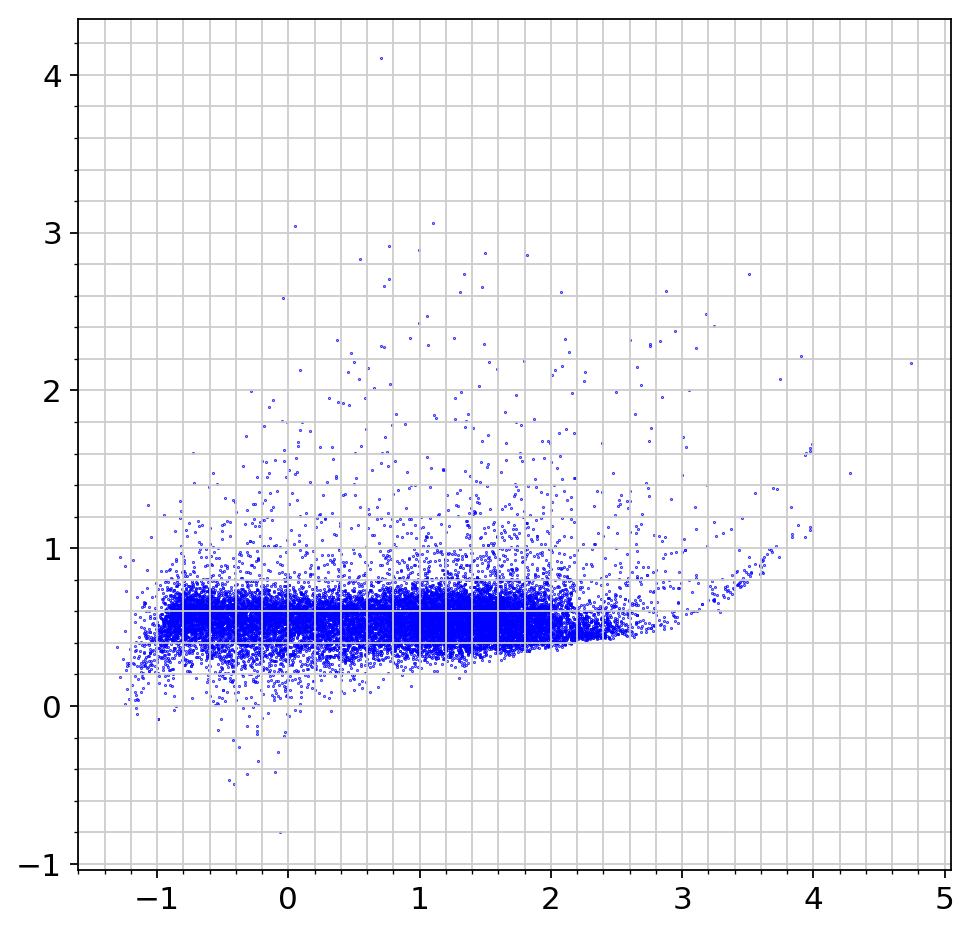

In [19]:
hv_plot(hv_adata, jointplot=True)

In [20]:
xrange = (0.2, 5)
yrange = (0, 4.2)
gate = np.array([(xrange[0], yrange[0]), 
                  (xrange[0], yrange[1]), 
                  (xrange[1], yrange[1]), 
                  (xrange[1], yrange[0])])

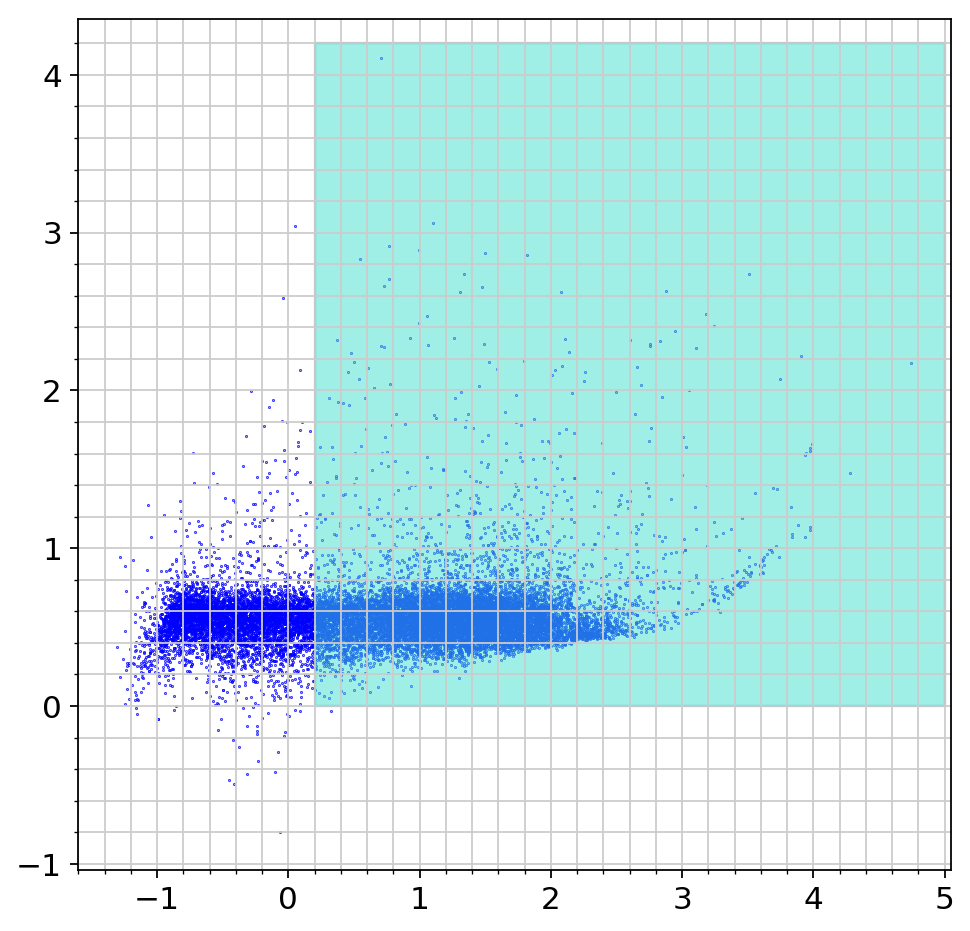

In [21]:
hv_plot(hv_adata, gate=gate)

In [22]:
genes = hv_genes(hv_adata, gate=gate)

You can check how many you have:

In [23]:
sum(genes)

12108

You can get a new adata object with your genes now subsetted:

In [25]:
concat['adata'] = hv_genes(hv_adata, gate=gate, adata=concat['adata'])

In [26]:
sc.pp.log1p(concat['adata'])

In [28]:
concat['adata']

AnnData object with n_obs × n_vars = 180813 × 12108 
    obs: 'DROPLET.TYPE', 'NUM.READS', 'NUM.SNPS', 'batch', 'cond', 'exp_id', 'free_id', 'n_counts', 'percent_mito', 'pool_code', 'viability_eq_ctrl', 'viability_sample'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts-0', 'n_counts-1', 'n_counts-2', 'n_counts-3', 'n_counts-4', 'n_counts-5', 'n_counts-6', 'n_counts-7', 'n_counts-8', 'n_counts-9', 'n_counts-10', 'n_counts-11', 'n_counts'
    uns: 'log1p'

In [108]:
concat['adata']

In [108]:
acg_concat = data['lo_mito'].concatenate(data['hi_mito'])

In [118]:
adata, dfs, angles = sc.external.pp.mnn_correct(data['lo_mito'], data['hi_mito'], svd_dim = 50, batch_key = 'mito', batch_categories = ['lo','hi'])

/home/ghartoularos/anaconda3/envs/sudoku/lib/python3.6/site-packages/mnnpy/utils.py:14: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "l2_norm" failed type inference due to: Invalid use of Function(<function norm at 0x7fd0e80abae8>) with argument(s) of type(s): (axis=Literal[int](1), x=array(float32, 2d, A))
 * parameterized
In definition 0:
    TypeError: norm_impl() got an unexpected keyword argument 'x'
    raised from /home/ghartoularos/.local/lib/python3.6/site-packages/numba/typing/templates.py:517
In definition 1:
    TypeError: norm_impl() got an unexpected keyword argument 'x'
    raised from /home/ghartoularos/.local/lib/python3.6/site-packages/numba/typing/templates.py:517
This error is usually caused by passing an argument of a type that is unsupported by the named function.
[1] During: resolving callee type: Function(<function norm at 0x7fd0e80abae8>)
[2] During: typing of call at /home/ghartoularos/anaconda3/envs/sudok

Performing cosine normalization...


/home/ghartoularos/anaconda3/envs/sudoku/lib/python3.6/site-packages/mnnpy/utils.py:14: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "l2_norm" failed type inference due to: Invalid use of Function(<function norm at 0x7fd0e80abae8>) with argument(s) of type(s): (axis=Literal[int](1), x=array(float32, 2d, A))
 * parameterized
In definition 0:
    TypeError: norm_impl() got an unexpected keyword argument 'x'
    raised from /home/ghartoularos/.local/lib/python3.6/site-packages/numba/typing/templates.py:517
In definition 1:
    TypeError: norm_impl() got an unexpected keyword argument 'x'
    raised from /home/ghartoularos/.local/lib/python3.6/site-packages/numba/typing/templates.py:517
This error is usually caused by passing an argument of a type that is unsupported by the named function.
[1] During: resolving callee type: Function(<function norm at 0x7fd0e80abae8>)
[2] During: typing of call at /home/ghartoularos/anaconda3/envs/sudok

Starting MNN correct iteration. Reference batch: 0
Step 1 of 1: processing batch 1
  Looking for MNNs...


KeyboardInterrupt: 